In [1]:
%%capture
##############################################################################
# IGNORE if you are running on a local machine and have all the dependencies #
##############################################################################

# installing dependencies --- to be able to run on google colab
# it would take 2-3 minutes

!yes | pip3 uninstall pandas
!yes | pip3 uninstall geopandas

!apt-get install libspatialindex-c4v5;
!pip3 install Rtree;
!pip3 install osmnx;
!pip3 install tqdm;
!pip3 install ipyleaflet;
!pip3 install pandas
!pip3 install geopandas==0.7.0
!pip3 install matplotlib==3.1.0
!pip3 install osmapi
!pip3 install geopy
!pip3 install plotly
!pip3 install folium

In [3]:
import osmnx as ox
from ipyleaflet import *
import networkx as nx
import plotly.graph_objects as obj
import numpy as np
import matplotlib.pylab as plt
import pandas as pd
import osmapi as osm
import time
from collections import deque
from tqdm import tqdm
from itertools import islice
from utilities import *
import requests
from pathlib import Path
import json
import csv
import osmapi as osm
from typing import Dict, List, Any

# Get live traffic incidents

In [4]:
from bing_traffic.models.bounding_box import BoundingBox
from bing_traffic.models.traffic_incident import TrafficIncident

bing_traffic_config = json.loads(Path("./bing_traffic/config.json").read_text())
north_york_region = bing_traffic_config['regions'][1]
north_york_bounding_box = BoundingBox(north_york_region['south_latitude'], north_york_region['west_longitude'], north_york_region['north_latitude'], north_york_region['east_longitude'])

base_url = 'http://dev.virtualearth.net/REST/v1/Traffic/Incidents'
key = 'Anis5hbe2SmsonKyg6x65ccbQyiBorY9TNtjrG-6-ru9H7u4IdOHq-yX-Oo5PXmW'
response = requests.get(f'{base_url}/{north_york_bounding_box}?key={key}')
json_response = json.loads(response.text)['resourceSets'][0]['resources']
traffic_incidents = [TrafficIncident(traffic_incident) for traffic_incident in json_response]

for traffic_incident in traffic_incidents:
    print(traffic_incident)

, 
                    Closed road from Allen Rd to ON-401 W.,
                    Severity: 4, 
                    Road closed: True, 
                    Start timestamp (utc): 2020-10-11 01:47:00, 
                    End timestamp (utc): 2020-10-11 09:21:54.647000, 
                    Origin coordinate: Lat = 43.731626, Lon = -79.449417, 
                    Destination coordinate: Lat = 43.729959, Lon = -79.453125
Lawrence Ave W WB, 
                    Slow traffic from Little Ave / Elsmere Ave to Little Ave / Hickory Tree Rd.,
                    Severity: 2, 
                    Road closed: False, 
                    Start timestamp (utc): 2020-10-10 17:28:00, 
                    End timestamp (utc): 2020-10-11 09:21:54.647000, 
                    Origin coordinate: Lat = 43.700744, Lon = -79.518314, 
                    Destination coordinate: Lat = 43.69991, Lon = -79.517217
Allen Rd NB, 
                    Roadwork from Eglinton Ave (Allen Rd) to Lawrence Ave (Allen R

# Create edges map of north york

In [5]:
from models.coordinate import Coordinate

edges_coords_map = {}
north_york_edges_coords_csv_file_path = Path('./map/data/north_york_edges_coords.csv')
with open(north_york_edges_coords_csv_file_path) as file:
    reader = csv.reader(file)
    rows = list(reader)
    for row in rows[1:]:
        osmid = int(row[0])
        lat = float(row[1])
        lon = float(row[2])
        edges_coords_map[osmid] = Coordinate([lat, lon])

for osmid, coord in edges_coords_map.items():
    print(osmid, coord)

4364699830 Lat = 43.714119, Lon = -79.4541078
262450448 Lat = 43.7797525, Lon = -79.4526662
2424895817 Lat = 43.7880362, Lon = -79.3314418
29657719 Lat = 43.7309426, Lon = -79.4462699
2295911766 Lat = 43.7591126, Lon = -79.3340408
1360086034 Lat = 43.7089815, Lon = -79.4287368
5595320422 Lat = 43.7708239, Lon = -79.4116635
1454583226 Lat = 43.7656478, Lon = -79.3927812
7127096400 Lat = 43.7622189, Lon = -79.4681354
2962738777 Lat = 43.7182275, Lon = -79.3760384
261694490 Lat = 43.7047922, Lon = -79.4902803
2235593745 Lat = 43.7192831, Lon = -79.4419535
1276660199 Lat = 43.7318523, Lon = -79.3492233
1967156815 Lat = 43.8039448, Lon = -79.3364771
547747612 Lat = 43.7732611, Lon = -79.5080653
2217331974 Lat = 43.747003, Lon = -79.4056066
6625547628 Lat = 43.7073409, Lon = -79.4820028
130033004 Lat = 43.7545377, Lon = -79.4534572
7428269000 Lat = 43.784158, Lon = -79.3647089
1811960417 Lat = 43.729206, Lon = -79.5229144
6685451463 Lat = 43.7707758, Lon = -79.3274004
7335193683 Lat = 43.733

# Load north york map

In [6]:
place = 'North York, Ontario, Canada'
G = ox.graph_from_place(place)
nodes, edges = ox.graph_to_gdfs(G)
edges_dic = pd.DataFrame(edges).to_dict()

# Helper functions to retrieve the coordinates of the edges

In [7]:
def get_node_coordinates(osmid: int) -> Coordinate:
    return edges_coords_map[osmid] if osmid in edges_coords_map else get_node_from_osmapi(osmid)

def get_node_from_osmapi(osmid: int) -> Coordinate:
    print(f'Fetch coord of osmid: {osmid}')
    api = osm.OsmApi()
    node = api.NodeGet(osmid)

    return Coordinate([node['lat'], node['lon']])

# Map the edges to a new list of type List[Edge]

In [8]:
from models.edge import Edge

edges = []
edges_processed_count = 1
edges_count = len(edges_dic['osmid'])
for i in range(edges_count):
    osmid = edges_dic['osmid'][i]
    edge_type = edges_dic['highway'][i]
    is_one_way = edges_dic['oneway'][i] 
    max_speed = edges_dic['maxspeed'][i]
    start_osmid = edges_dic['u'][i]
    start_coordinate = get_node_coordinates(start_osmid)
    end_osmid = edges_dic['v'][i]
    end_coordinate = get_node_coordinates(end_osmid)
    
    edges.append(Edge(osmid, edge_type, is_one_way, max_speed, start_osmid, end_osmid, start_coordinate, end_coordinate))
    
    print(f'{edges_processed_count}/{edges_count}')
    edges_processed_count += 1

for edge in edges:
    print(edge)

1/98582
2/98582
3/98582
4/98582
5/98582
6/98582
7/98582
8/98582
9/98582
10/98582
11/98582
12/98582
13/98582
14/98582
15/98582
16/98582
17/98582
18/98582
19/98582
20/98582
21/98582
22/98582
23/98582
24/98582
25/98582
26/98582
27/98582
28/98582
29/98582
30/98582
31/98582
32/98582
33/98582
34/98582
35/98582
36/98582
37/98582
38/98582
39/98582
40/98582
41/98582
42/98582
43/98582
44/98582
45/98582
46/98582
47/98582
48/98582
49/98582
50/98582
51/98582
52/98582
53/98582
54/98582
55/98582
56/98582
57/98582
58/98582
59/98582
60/98582
61/98582
62/98582
63/98582
64/98582
65/98582
66/98582
67/98582
68/98582
69/98582
70/98582
71/98582
72/98582
73/98582
74/98582
75/98582
76/98582
77/98582
78/98582
79/98582
80/98582
81/98582
82/98582
83/98582
84/98582
85/98582
86/98582
87/98582
88/98582
89/98582
90/98582
91/98582
92/98582
93/98582
94/98582
95/98582
96/98582
97/98582
98/98582
99/98582
100/98582
101/98582
102/98582
103/98582
104/98582
105/98582
106/98582
107/98582
108/98582
109/98582
110/98582
111/9858

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Edge: 35834790,
                    edge_type: residential,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 418973341,
                    end_osmid: 552589200,
                    start_coordinate: Lat = 43.7484113, Lon = -79.4028496,
                    end_coordinate: Lat = 43.7484201, Lon = -79.4029151
Edge: 35834795,
                    edge_type: tertiary,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 418973341,
                    end_osmid: 253156834,
                    start_coordinate: Lat = 43.7484113, Lon = -79.4028496,
                    end_coordinate: Lat = 43.7485311, Lon = -79.4028158
Edge: 35834796,
                    edge_type: tertiary,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 418973341,
                    end_osmid: 1177547953,
                    start_coordinate: Lat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Edge: 112282732,
                    edge_type: footway,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 1276664495,
                    end_osmid: 1276664529,
                    start_coordinate: Lat = 43.734059, Lon = -79.3586634,
                    end_coordinate: Lat = 43.7340339, Lon = -79.3586475
Edge: 112282730,
                    edge_type: footway,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 1276664495,
                    end_osmid: 1276664475,
                    start_coordinate: Lat = 43.734059, Lon = -79.3586634,
                    end_coordinate: Lat = 43.734242, Lon = -79.3584748
Edge: 112282732,
                    edge_type: footway,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 1276664495,
                    end_osmid: 1426924463,
                    start_coordinate: Lat =

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Edge: 54209709,
                    edge_type: footway,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 1996547750,
                    end_osmid: 1550781833,
                    start_coordinate: Lat = 43.7980893, Lon = -79.3696607,
                    end_coordinate: Lat = 43.7996321, Lon = -79.3700462
Edge: 189007582,
                    edge_type: service,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 1996548595,
                    end_osmid: 1996548602,
                    start_coordinate: Lat = 43.7992749, Lon = -79.3711363,
                    end_coordinate: Lat = 43.7996763, Lon = -79.3713022
Edge: 189007585,
                    edge_type: service,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 1996548595,
                    end_osmid: 1996548602,
                    start_coordinate: Lat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Edge: 441602758,
                    edge_type: path,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 4393415611,
                    end_osmid: 5898173830,
                    start_coordinate: Lat = 43.765204, Lon = -79.350362,
                    end_coordinate: Lat = 43.7644083, Lon = -79.3518277
Edge: 441602755,
                    edge_type: path,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 4393415617,
                    end_osmid: 4393415611,
                    start_coordinate: Lat = 43.763758, Lon = -79.3496729,
                    end_coordinate: Lat = 43.765204, Lon = -79.350362
Edge: [32944091, 441602756],
                    edge_type: ['path', 'footway'],
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 4393415617,
                    end_osmid: 678885350,
                    start_c

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Edge: 814290404,
                    edge_type: footway,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 7314354501,
                    end_osmid: 3033743332,
                    start_coordinate: Lat = 43.7789202, Lon = -79.332661,
                    end_coordinate: Lat = 43.7786358, Lon = -79.3379377
Edge: 299367212,
                    edge_type: residential,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 7314354502,
                    end_osmid: 267468396,
                    start_coordinate: Lat = 43.7789508, Lon = -79.3325064,
                    end_coordinate: Lat = 43.7795846, Lon = -79.332759
Edge: 299367212,
                    edge_type: residential,
                    is_one_way: False,
                    max_speed: [nan],
                    start_osmid: 7314354502,
                    end_osmid: 267467898,
                    start_coordinate

# Checks if the subgraph edge nodes are in the north-york edges

In [11]:
def is_sg_edge_north_york_edges(u: int, v: int, edges: List[Edge]) -> bool:
    for edge in edges:
        if edge.start_osmid == u and edge.end_osmid == v:
            return True
    
    return False

#  Explore the subgraph of each traffic incident 

In [ ]:
print(f'Total accidents: {len(traffic_incidents)}')
traffic_incidents_processed_count = 1
for traffic_incident in traffic_incidents:
    print(f'({traffic_incidents_processed_count}/{len(traffic_incidents)}) {traffic_incident}')
    origin_coord = traffic_incident.origin_coordinate
    traffic_origin_point = (origin_coord.latitude, origin_coord.longitude) 
    print(f'Traffic incident origin: {traffic_origin_point}')
    
    search_radius_in_meters = 100
    try:
        SG = ox.graph_from_point(traffic_origin_point, search_radius_in_meters)
        _, sg_edges = ox.graph_to_gdfs(SG)      # Convert node and edge GeoDataFrames to a MultiDiGraph.
        sg_edges_dic = pd.DataFrame(sg_edges).to_dict()
        sg_edges_count = len(sg_edges_dic['osmid'])
        print(f'Subgraph ({search_radius_in_meters}m) edges count: ' + str(sg_edges_count))
        sg_edge_found_in_edges_count = 0
        for i in range(sg_edges_count):
            sg_edge_start_osmid = sg_edges_dic['u'][i]
            sg_edge_end_osmid = sg_edges_dic['v'][i]
            
            if (is_sg_edge_north_york_edges(sg_edge_start_osmid, sg_edge_end_osmid, edges)):
                sg_edge_found_in_edges_count += 1

        print(f'TOTAL subgraph edges found in north-york: {sg_edge_found_in_edges_count}/{sg_edges_count}')    
        print('')    
    except:
        print(f'SKIP subgraph is null / undefined')
    
    traffic_incidents_processed_count += 1

Total accidents: 82
(1/82) , 
                    Closed road from Allen Rd to ON-401 W.,
                    Severity: 4, 
                    Road closed: True, 
                    Start timestamp (utc): 2020-10-11 01:47:00, 
                    End timestamp (utc): 2020-10-11 09:21:54.647000, 
                    Origin coordinate: Lat = 43.731626, Lon = -79.449417, 
                    Destination coordinate: Lat = 43.729959, Lon = -79.453125
Traffic incident origin: (43.731626, -79.449417)
SKIP subgraph is null / undefined
(2/82) Lawrence Ave W WB, 
                    Slow traffic from Little Ave / Elsmere Ave to Little Ave / Hickory Tree Rd.,
                    Severity: 2, 
                    Road closed: False, 
                    Start timestamp (utc): 2020-10-10 17:28:00, 
                    End timestamp (utc): 2020-10-11 09:21:54.647000, 
                    Origin coordinate: Lat = 43.700744, Lon = -79.518314, 
                    Destination coordinate: Lat = 43.699

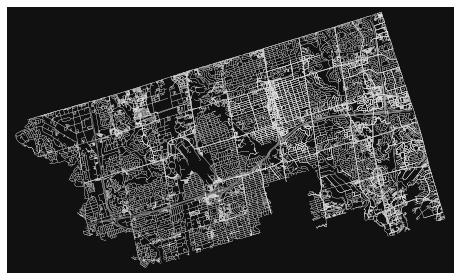

In [ ]:
place = 'North York, Ontario, Canada'
G = ox.graph_from_place(place)
fig, ax = ox.plot_graph(G, node_size=0, edge_color='w', edge_linewidth=0.2)  # display the city of North York 

In [ ]:
nodes, edges = ox.graph_to_gdfs(G)      # Convert node and edge GeoDataFrames to a MultiDiGraph.
# print("Nodes:\n", nodes.head(), '\n')   
# print("Edges:\n", edges.head(), '\n')
# print("Type:", type(edges)) 

# print("Nodes:", nodes);
# print("Edges:", edges);
df = pd.DataFrame(edges)  # data frame 
dic = df.to_dict()

print(len(dic['u']), len(dic['v']))
print(dic['u'][0])
print(dic['v'][0])
print(dic['maxspeed'][0])
print(dic['highway'][0])
print(dic['geometry'][0])
print(dic['oneway'][0])

api = osm.OsmApi()
id_info = api.NodeGet(dic['v'][0])
point = (id_info['lat'], id_info['lon']) # lat (y), lon (x) 
print(point)

# all_nodes = list(nodes.to_dict()['osmid'].keys()) 
# index_element = all_nodes.index(dic['u'][0])
# print(index_element)
# index_element = all_nodes.index(dic['u'][0])
# print(index_element)

# print(dic['u'])
# print(dic['v'])
# print(dic['osmid'])
# print(dic['maxspeed'])

dic.keys()

98389 98389
1497768
1497793
90
motorway
LINESTRING (-79.3327357 43.7450436, -79.3328369 43.7454806, -79.33295889999999 43.7459924, -79.3331111 43.7466704, -79.3332228 43.747316, -79.3332826 43.7478616, -79.3333255 43.7484115, -79.333434 43.7496991, -79.33346160000001 43.7501978, -79.3334777 43.750338, -79.3335368 43.7508526, -79.3336887 43.7518932, -79.3337332 43.7521525, -79.3339332 43.7530819, -79.3341564 43.7539499, -79.3345023 43.7550349)
True
(43.7550349, -79.3345023)


dict_keys(['osmid', 'oneway', 'lanes', 'ref', 'name', 'highway', 'maxspeed', 'length', 'bridge', 'geometry', 'access', 'tunnel', 'service', 'width', 'junction', 'area', 'u', 'v', 'key'])

# Option 1: Using Nominatim API

Based on the analysis it does not pickout many points. We can go with option 2 for now. 



In [ ]:
class Amenity: 
  def __init__(self, amenity, lat, lon, address):
    self.amenity = amenity
    self.lat = float(lat)
    self.lon = float(lon)
    self.address = address
    self.coordinates = (float(lon), float(lat))

In [ ]:
amenities = []

firestation_link = 'https://nominatim.openstreetmap.org/?addressdetails=1&q=fire+stations+in+north+york&format=json'
hospitals_link = 'https://nominatim.openstreetmap.org/?addressdetails=1&q=hospitals+in+north+york&format=json'

links = [firestation_link, hospitals_link]

for link in links:  
  response = requests.get(link)

  if response.status_code != 200:
      raise ValueError("We couldn't decode the address, please make sure you entered it correctly")

  response_json = response.json()

  for place in response_json:
    amenities.append(Amenity(place['type'], place['lat'], place['lon'], place['display_name']))
    # print(place['type'], place['display_name'], place['lat'], place['lon'])

In [ ]:
critical_amenity_nodes = []
# nc = ['w'] * len(nodes)
# ns = [10 if node in amenities else 0 for node in G.nodes()]

for place in amenities:
  point = (place.lat, place.lon) # lat (y), lon (x) 
  pt_nearest_node_euc = ox.get_nearest_node(G, point, method='euclidean')
  critical_amenity_nodes.append((pt_nearest_node_euc, place.amenity))


In [ ]:
def node_color_and_size(critical_nodes, nodes):
  node_colors = ['w'] * len(nodes)
  node_size = [0] * len(nodes)
  for place in critical_nodes: 
    idx = nodes.index(place[0])
    if (place[1] == 'fire_station'):
      node_colors[idx] = 'b'
    elif (place[1] == 'hospital'):
      node_colors[idx] = 'r'
    node_size[idx] = 10
  return node_colors, node_size

print(critical_amenity_nodes)

[(6625542542, 'fire_station'), (6624988064, 'fire_station'), (6146538057, 'fire_station'), (6625542206, 'fire_station'), (6625539958, 'fire_station'), (6625032745, 'fire_station'), (6625041950, 'fire_station'), (6625545311, 'fire_station'), (259756241, 'fire_station'), (259756241, 'fire_station'), (7347291851, 'hospital'), (5253530261, 'hospital'), (147134435, 'hospital'), (3110479750, 'hospital'), (4177446662, 'hospital'), (259756241, 'hospital'), (259756241, 'hospital'), (259756241, 'hospital')]


31404
31382
30127
31400
31399
31386
31390
31405
2897
2897
33283
28153
1745
24518
25474
2897
2897
2897


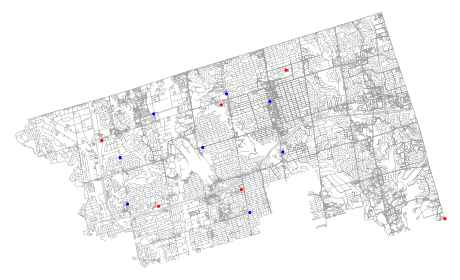

In [ ]:
all_nodes = list(nodes.to_dict()['osmid'].keys())
nc, ns = node_color_and_size(critical_amenity_nodes, all_nodes)

fig, ax = ox.plot_graph(G, node_color=nc, node_size=ns, edge_linewidth=0.2, bgcolor = 'white')

# Option 2/2: Using OpenStreetMap node IDs API

This highlights many amenities. Seems to be a good option here.

In [ ]:
class Amenity: 
  def __init__(self, amenity, lat, lon, name, osmid, nearestNode):
    self.amenity = amenity
    self.lat = float(lat)
    self.lon = float(lon)
    self.name = name
    self.osmid = osmid 
    self.nearestNode = nearestNode

In [ ]:
# Get all the important things we need to highlight on the map
tags = {
    'amenity':['hospital', 'fire_station'],
}
emergency_locations = ox.geometries_from_place(place, tags=tags)
print(emergency_locations)
df = pd.DataFrame(emergency_locations)  # data frame 
dic = df.to_dict()

          unique_id       osmid  ... wheelchair               wikipedia:en
0    node/609290577   609290577  ...        NaN                        NaN
1   node/1601962650  1601962650  ...        NaN                        NaN
2      way/27006473    27006473  ...        NaN                        NaN
3      way/31372887    31372887  ...        NaN                        NaN
4      way/43806314    43806314  ...        NaN                        NaN
5      way/60428611    60428611  ...        NaN                        NaN
6      way/68021042    68021042  ...        NaN                        NaN
7     way/108700348   108700348  ...        NaN                        NaN
8     way/109199283   109199283  ...        NaN                        NaN
9     way/111664202   111664202  ...        NaN                        NaN
10    way/120882312   120882312  ...        NaN                        NaN
11    way/124105159   124105159  ...        NaN                        NaN
12    way/130468302   130

In [ ]:
amenities = []

api = osm.OsmApi() # using this to find lat and lon
for i in range(len(list_osmids)):
  if ("node" in dic['unique_id'][i]):
    nodeId= dic['osmid'][i]
  elif ("way" in dic['unique_id'][i]):
    nodeId = dic['nodes'][i][0]

  id_info = api.NodeGet(nodeId)
  point = (id_info['lat'], id_info['lon']) # lat (y), lon (x) 
  pt_nearest_node_euc = ox.get_nearest_node(G, point, method='euclidean')
  
  # amenity, lat, lon, name, osmid, nearestNode
  amenities.append(Amenity(dic['amenity'][i], id_info['lat'], id_info['lon'], 
                           dic['name'][i], dic['osmid'][i], pt_nearest_node_euc))
  

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: ResourceWarning:

unclosed <ssl.SSLSocket fd=50, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('172.28.0.2', 49846)>



In [ ]:
def find_element_in_list(element, list_element):
    try:
        index_element = list_element.index(element)
        return index_element
    except ValueError:
        return -1

def node_color_and_size(amenities, nodes):
  node_colors = ['w'] * len(nodes)
  node_size = [0] * len(nodes)
  for i in range(len(amenities)): 
    idx = find_element_in_list(amenities[i].nearestNode, nodes)
    if (idx != -1):
      if (amenities[i].amenity == 'fire_station'):
        node_colors[idx] = 'b'
      if (amenities[i].amenity == 'hospital'):
        node_colors[idx] = 'r'
      node_size[idx] = 10
  return node_colors, node_size

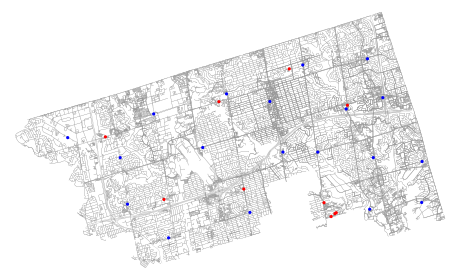

In [ ]:
all_nodes = list(nodes.to_dict()['osmid'].keys())
nc, ns = node_color_and_size(amenities, all_nodes)

fig, ax = ox.plot_graph(G, node_color=nc, node_size=ns, edge_linewidth=0.2, bgcolor = 'white')

Stategy going forward: 
1. Heat map of traafic data 
2. Implement the algorithm - currently we are utilizing the algorithm from prof

# The Algorithm

## -------- DFS -----------

In [ ]:

# first define the origin/source nodes as Node
origin = Node(graph = G, osmid = amenities[0].nearestNode)
destination = Node(graph = G, osmid = amenities[3].nearestNode)

In [ ]:
%%time 
bar = tqdm(total=len(G))

route = []
frontier = deque([origin])
explored = set()
found = False
while frontier and not found:
    bar.update(1); time.sleep(0.05)
    node = frontier.pop()
    explored.add(node)
    for child in node.expand():
        if child not in explored and child not in frontier:
            if child == destination:
                route  = child.path()
                found = True
                continue
            frontier.append(child)

bar.close()
print("The route is \n\n",route, "\n\nits cost is\n\n", cost(G, route))

 25%|██▌       | 8815/35101 [07:33<22:33, 19.42it/s]

The route is 

 [6624988064, 7368052431, 7127096569, 7127096567, 261631317, 261631491, 7824126406, 1814304153, 1814304152, 261631540, 1333963652, 4315968214, 4315968216, 7127096563, 7127096564, 7127096546, 5777975648, 5777975647, 7127096541, 7368092038, 5670217272, 3447489202, 7368092015, 7368092012, 7368092002, 6474228780, 6474235297, 6474235311, 6842674658, 48490673, 1721319579, 6474235326, 7368091985, 7368091987, 7368091989, 48489536, 7244814028, 7244814019, 7244814018, 48487794, 48494741, 48495722, 48495726, 48496115, 253013816, 430878370, 430878300, 4948911358, 414424283, 430877776, 1245025174, 430878081, 430878425, 430877819, 430877721, 7250327562, 7250327570, 430878136, 809117253, 809232794, 809136544, 809136549, 809130585, 809130579, 5978796615, 5978796611, 809126912, 809117284, 430878477, 809126917, 6225873776, 253012447, 430878326, 430878484, 430878131, 430877969, 430877908, 253013434, 48496770, 4589183201, 4589183203, 4589183202, 4589183206, 5908603285, 4590854797, 48498576,

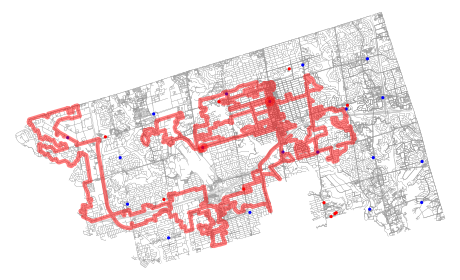

In [ ]:
fig, ax = ox.plot_graph_route(G, route=route, node_color=nc, node_size=ns, edge_linewidth=0.2, bgcolor = 'white')

## -------- A* -----------

  0%|          | 3/35101 [00:00<20:19, 28.78it/s]

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 7.87 µs


  1%|          | 416/35101 [00:21<29:23, 19.67it/s]


The route is 

 [6624988064, 7368052431, 7368052433, 7368052434, 4550421840, 37016874, 4508806097, 130033865, 59943869, 130033004, 130033753, 130033552, 130033752, 130033751, 130033742, 130033745, 130033439, 84995922, 84997188, 6832060037, 130034184, 1272601850, 6832060049, 130034131, 529593356, 560654489, 560654512, 560654518, 7951336331, 7951336326, 7951336325, 7951336300, 7951336293, 248493828, 248493826, 248493825, 248493820, 1416788711, 248493821, 1416788713, 252363483, 1453370230, 1453370243, 1453370244, 1453370247, 1453370249, 1453370257, 5667681790, 6893295597, 6893280964, 6893295596, 6893280956, 5667039425, 6893280954, 5667039421, 5667039422, 6146537991, 6146537990, 6146537988, 6146538024, 6146537993, 6146531584, 6146538049, 6146538048] 

its cost is

 6629.397000000002


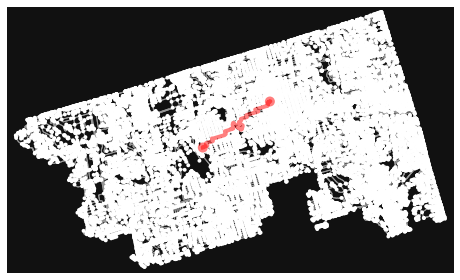

In [ ]:
# toGoal, toDestination = astar_heuristic(G, origin.osmid, destination.osmid)
toGoal, toDestination = astar_heuristic(G, origin.osmid, destination.osmid)

%time
route = []
frontier = list()

bar = tqdm(total=len(G)) # for the progress bar

frontier.append(origin)
explored = set()
found = False

while frontier and not found:
    bar.update(1); time.sleep(0.05)
    
    # choose a node based on its heuristic value
    node = min(frontier, key = lambda node : toGoal[node.osmid] + toDestination[node.osmid])
    frontier.remove(node)
    explored.add(node)
    
    # expand its children
    for child in node.expand():
        if child not in explored and child not in frontier:
            if child == destination:
                route = child.path()
                found = True
                continue
            frontier.append(child)

bar.close()
print("The route is \n\n",route, "\n\nits cost is\n\n", cost(G, route))

fig, ax = ox.plot_graph_route(G, route)

--------------------------------------------------------------------------

# **TESTING ONWARDS** - Ignore

In [ ]:
place = 'University of Toronto'
G = ox.graph_from_place(place)
nodes, edges = ox.graph_to_gdfs(G)

keys = list(nodes.to_dict()['osmid'].keys())
print (keys)


[20979742, 21631731, 24959527, 24959528, 24959535, 24959545, 24959546, 24959547, 24959549, 24959550, 24959551, 24959555, 24959556, 24959559, 24959560, 24960058, 24960060, 24960063, 24960068, 24960070, 24960073, 24960076, 24960080, 50885141, 50885147, 50885160, 50897854, 50897859, 50897869, 50897874, 55808451, 55808512, 55808518, 55808527, 55808564, 55808571, 55808582, 55808839, 59817393, 59817394, 60052037, 60052038, 60052040, 60052042, 60052047, 60052048, 60052049, 60052050, 60654119, 60654120, 60654129, 60654133, 80927418, 80927426, 87475456, 87475463, 123347786, 123347984, 127275360, 127283024, 127284677, 127284680, 127289393, 130170945, 215726254, 239055725, 239055729, 242413453, 243633234, 244213560, 244213561, 249991437, 253815363, 253815365, 253815479, 262732431, 262732432, 262732448, 262817257, 262817259, 299625331, 303255446, 304885460, 304888562, 304890340, 304890341, 304892018, 305862114, 306721038, 306721042, 306721055, 306721057, 306725181, 306725184, 306729816, 306729822,

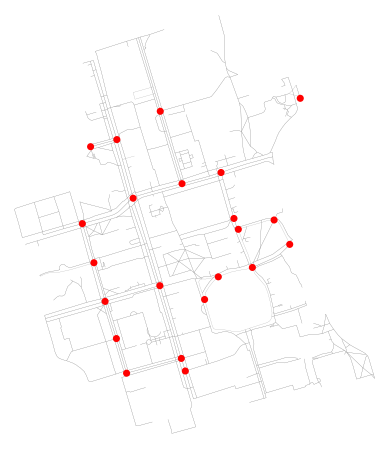

In [ ]:
def find_element_in_list(element, list_element):
    try:
        index_element = list_element.index(element)
        return index_element
    except ValueError:
        return -1

highlight_nodes = [20979742, 21631731, 24959527, 24959528, 24959535, 24959545, 24959546, 24959547, 24959549, 24959550, 24959551, 24959555, 24959556, 24959559, 24959560, 24960058, 24960060, 24960063, 24960068, 24960070, 24960073, 24960076]
colors = ['w'] * len(keys)
size = [0] * len(keys)
for i in range(len(highlight_nodes)): 
  idx = find_element_in_list(highlight_nodes[i], keys)
  if (idx != -1):
    colors[idx] = 'r'
    size[idx] = 50

fig, ax = ox.plot_graph(G, node_color=colors, node_size=size, edge_linewidth=0.2, bgcolor = 'white')

In [ ]:
api = osm.OsmApi() # this instantiate the OsmApi class,
# it has many function, we will use NodeGet function.
# For more detail about it check the doc
# http://osmapi.metaodi.ch/#osmapi.OsmApi.OsmApi.NodeGet

# for id in size(dic['osmid']):
#   id_info = api.NodeGet(dic['osmid'][3])

node = api.NodeGet(dic['nodes'][3])
lat = node['lat']
lon = node['lon']
# print(node)
pt_nearest_node_euc = ox.get_nearest_node(G, (lat, lon), method='euclidean')
print(node)
print(pt_nearest_node_euc)
G.nodes[pt_nearest_node_euc]

NameError: ignored

In [ ]:
!pip3 install geopy
